# Análisis de delitos de la Ciudad de Buenos Aires

## LIbrerías utilizadas

In [1]:
import pandas as pd
import os
import seaborn as sns
from plotnine import *
import matplotlib.pyplot as plt
import geopandas as gpd
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', None)

/var/folders/rl/8r_3m_r94_j58zn6wmg4r9m80000gn/T/ipykernel_1523/2258643928.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


## Lectura de datos y transformaciones

In [5]:
# Lectura de datasets de delitos

# Directorio donde se encuentran los archivos CSV
directorio = '../Datasets/'

# Obtener la lista de archivos CSV en el directorio
archivos_csv = [archivo for archivo in os.listdir(directorio) if archivo.startswith('delitos_') and archivo.endswith('.csv')]

# Inicializar un DataFrame vacío para almacenar los datos
delitos = pd.DataFrame()

# Leer cada archivo CSV y concatenarlos en el DataFrame final
for archivo in archivos_csv:
    ruta_archivo = os.path.join(directorio, archivo)
    df_temporal = pd.read_csv(ruta_archivo)
    delitos = pd.concat([delitos, df_temporal], ignore_index=True)



# Lectura de otros datasets
comisarias = pd.read_csv('../Datasets/comisarias-policia-de-la-ciudad.csv')

from urllib.request import urlopen
import json
with urlopen('https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson') as response:
    barrios_geojson = json.load(response)



# Modificar tipo de dato
delitos['fecha'] = pd.to_datetime(delitos['fecha'])
delitos['franja'] = delitos['franja'].astype('Int32')
delitos['comuna'] = delitos['comuna'].astype('Int32')


# Añadir nuevas columnas
delitos['mes_numero'] = delitos['fecha'].dt.month
delitos['dia_numero'] = delitos['fecha'].dt.isocalendar().day
delitos['dia_mes_numero'] = delitos['fecha'].dt.day
#delitos['anio_mes'] = delitos['fecha'].dt.to_period('M')
delitos['anio_mes'] = pd.to_datetime(delitos['fecha'], format='%Y-%m').dt.to_period('M')


# Eliminamos registros que no nos interesan para el análisis


delitos = delitos[-delitos['tipo'].isin(['Homicidios', 'Amenazas', 'Lesiones'])]


# Seleccionamos solo registros de robos y hurtos

robos = delitos[delitos['subtipo'].isin(['Hurto total', 'Robo total'])]


# Eliminamos los registros que no tienen ubicación

cols = ['barrio', 'comuna', 'latitud', 'longitud']
robos = robos.dropna(subset = cols).reset_index(drop=True)

# Guardamos el fichero de robos en un dataframe
robos.to_csv('../Datasets/robos_all_years.csv', index=False)


In [12]:
robos

,id-mapa,anio,mes,dia,fecha,franja,tipo,subtipo,uso_arma,uso_moto,barrio,comuna,latitud,longitud,cantidad,mes_numero,dia_numero,dia_mes_numero,anio_mes
0,252569,2019,ENERO,LUNES,2019-01-28,8,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4,-34.630835,-58.391528,1,1,1,28,2019-01
1,252570,2019,MARZO,LUNES,2019-03-04,11,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4,-34.628442,-58.391876,1,3,1,4,2019-03
2,252571,2019,ABRIL,MIERCOLES,2019-04-10,18,Robo,Robo total,NO,NO,PARQUE PATRICIOS,4,-34.630313,-58.391512,1,4,3,10,2019-04
3,252572,2019,NOVIEMBRE,LUNES,2019-11-18,12,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4,-34.630163,-58.391542,1,11,1,18,2019-11
4,252573,2019,ABRIL,LUNES,2019-04-01,17,Robo,Robo total,NO,NO,PARQUE PATRICIOS,4,-34.629944,-58.391882,1,4,1,1,2019-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
653520,831327,2017,DICIEMBRE,DOMINGO,2017-12-31,23,Hurto,Hurto total,NO,NO,VILLA URQUIZA,12,-34.569537,-58.488005,1,12,7,31,2017-12
653521,831330,2017,DICIEMBRE,DOMINGO,2017-12-31,14,Hurto,Hurto total,NO,NO,BELGRANO,13,-34.559850,-58.452968,1,12,7,31,2017-12
653522,831333,2017,DICIEMBRE,DOMINGO,2017-12-31,0,Hurto,Hurto total,NO,NO,NUÑEZ,13,-34.552862,-58.462993,1,12,7,31,2017-12
653523,831336,2017,DICIEMBRE,DOMINGO,2017-12-31,9,Hurto,Hurto total,NO,NO,VILLA PUEYRREDON,12,-34.572164,-58.505348,1,12,7,31,2017-12


In [3]:
robos.shape

(653525, 19)

In [11]:
robos.groupby(['comuna', 'barrio'])['cantidad'].sum()

comuna  barrio           
1.0     CONSTITUCION         19368
        MONSERRAT            16268
        PUERTO MADERO         1144
        RETIRO               18299
        SAN NICOLAS          30652
        SAN TELMO             8963
2.0     RECOLETA             32943
3.0     BALVANERA            48045
        SAN CRISTOBAL        11252
4.0     BARRACAS             19885
        BOCA                  9427
        NUEVA POMPEYA        14292
        PARQUE PATRICIOS     11001
5.0     ALMAGRO              27251
        BOEDO                 9886
6.0     CABALLITO            30055
7.0     FLORES               34159
        PARQUE CHACABUCO     13833
8.0     VILLA LUGANO         20552
        VILLA RIACHUELO       2930
        VILLA SOLDATI        10979
9.0     LINIERS              10878
        MATADEROS            14318
        PARQUE AVELLANEDA     9931
10.0    FLORESTA              8207
        MONTE CASTRO          5203
        VELEZ SARSFIELD       5784
        VERSALLES            

In [23]:
robos.sort_values('fecha', ascending=False).head()

,id-mapa,anio,mes,dia,fecha,franja,tipo,subtipo,uso_arma,uso_moto,barrio,comuna,latitud,longitud,cantidad,mes_numero,dia_numero,dia_mes_numero,anio_mes
580267,83152,2022,DICIEMBRE,SABADO,2022-12-31,11.0,Hurto,Hurto total,NO,NO,FLORES,7.0,-34.630087,-58.462238,1,12,6,31,2022-12
552210,55095,2022,DICIEMBRE,SABADO,2022-12-31,20.0,Hurto,Hurto total,NO,NO,BELGRANO,13.0,-34.573220,-58.461563,1,12,6,31,2022-12
505725,8610,2022,DICIEMBRE,SABADO,2022-12-31,5.0,Robo,Robo total,NO,NO,BALVANERA,3.0,-34.611891,-58.410239,1,12,6,31,2022-12
505724,8609,2022,DICIEMBRE,SABADO,2022-12-31,23.0,Robo,Robo total,NO,NO,BALVANERA,3.0,-34.607417,-58.410306,1,12,6,31,2022-12
505722,8607,2022,DICIEMBRE,SABADO,2022-12-31,0.0,Robo,Robo total,NO,NO,ALMAGRO,5.0,-34.600242,-58.412284,1,12,6,31,2022-12


In [24]:
robos.subtipo.value_counts()

subtipo
Robo total     391941
Hurto total    261761
Name: count, dtype: int64

In [25]:
robos.shape

(653702, 19)

In [26]:
robos.duplicated(subset=['latitud', 'longitud']).sum()

354176

In [7]:
delitos.tipo.value_counts()

tipo
Robo        409373
Hurto       296621
Vialidad     63483
Name: count, dtype: int64

In [7]:
delitos.info()

<class 'pandas.core.frame.DataFrame'>
Index: 769477 entries, 0 to 939683
Data columns (total 19 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   id-mapa         769477 non-null  int64         
 1   anio            769477 non-null  int64         
 2   mes             769477 non-null  object        
 3   dia             769477 non-null  object        
 4   fecha           769477 non-null  datetime64[ns]
 5   franja          767383 non-null  float64       
 6   tipo            769477 non-null  object        
 7   subtipo         769477 non-null  object        
 8   uso_arma        769477 non-null  object        
 9   uso_moto        769477 non-null  object        
 10  barrio          758390 non-null  object        
 11  comuna          758388 non-null  float64       
 12  latitud         758609 non-null  float64       
 13  longitud        758609 non-null  float64       
 14  cantidad        769477 non-null  int64   

In [8]:
delitos.head()

,id-mapa,anio,mes,dia,fecha,franja,tipo,subtipo,uso_arma,uso_moto,barrio,comuna,latitud,longitud,cantidad,mes_numero,dia_numero,dia_mes_numero,anio_mes
0,252569,2019,ENERO,LUNES,2019-01-28,8.0,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4.0,-34.630835,-58.391528,1,1,1,28,2019-01
1,252570,2019,MARZO,LUNES,2019-03-04,11.0,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4.0,-34.628442,-58.391876,1,3,1,4,2019-03
2,252571,2019,ABRIL,MIERCOLES,2019-04-10,18.0,Robo,Robo total,NO,NO,PARQUE PATRICIOS,4.0,-34.630313,-58.391512,1,4,3,10,2019-04
3,252572,2019,NOVIEMBRE,LUNES,2019-11-18,12.0,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4.0,-34.630163,-58.391542,1,11,1,18,2019-11
4,252573,2019,ABRIL,LUNES,2019-04-01,17.0,Robo,Robo total,NO,NO,PARQUE PATRICIOS,4.0,-34.629944,-58.391882,1,4,1,1,2019-04


## Estadísticas

In [9]:
delitos.tipo.value_counts()

tipo
Robo        409373
Hurto       296621
Vialidad     63483
Name: count, dtype: int64

In [10]:
delitos.groupby(['tipo', 'subtipo'])['cantidad'].sum()

tipo      subtipo                       
Hurto     Hurto automotor                    33117
          Hurto total                       263504
Robo      Robo automotor                     13377
          Robo total                        395996
Vialidad  Lesiones por siniestros viales     62656
          Muertes por siniestros viales        827
Name: cantidad, dtype: int64

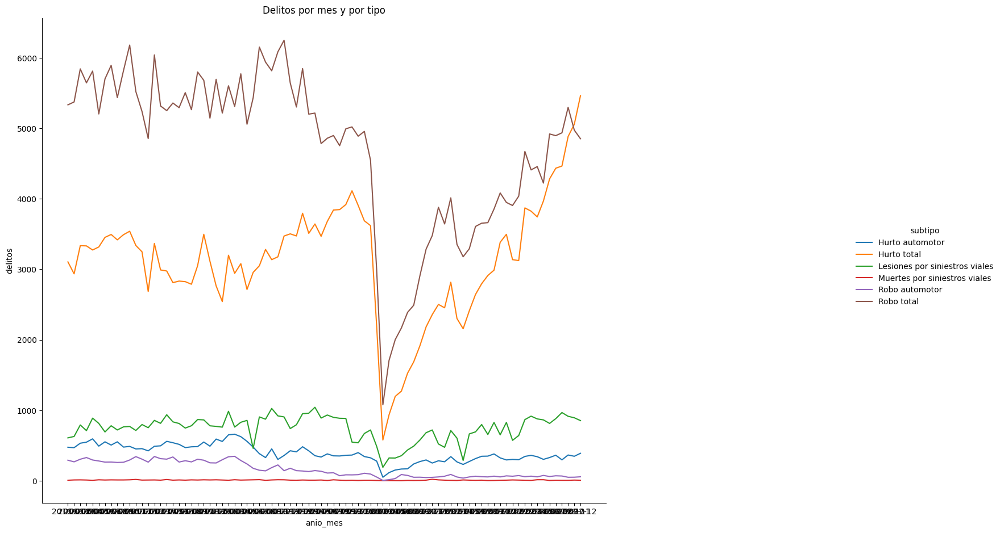

In [11]:
delitos_por_mes = delitos.groupby(['anio_mes', 'subtipo'])['cantidad'].sum().reset_index().rename(columns = {'cantidad':'delitos'})

sns.relplot(data = delitos_por_mes,
             x = delitos_por_mes['anio_mes'].astype(str), 
             y = 'delitos',
             hue = 'subtipo',
             kind = 'line')

plt.title('Delitos por mes y por tipo')
plt.gcf().set_size_inches(20, 10)

In [12]:
robos

,id-mapa,anio,mes,dia,fecha,franja,tipo,subtipo,uso_arma,uso_moto,barrio,comuna,latitud,longitud,cantidad,mes_numero,dia_numero,dia_mes_numero,anio_mes
0,252569,2019,ENERO,LUNES,2019-01-28,8.0,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4.0,-34.630835,-58.391528,1,1,1,28,2019-01
1,252570,2019,MARZO,LUNES,2019-03-04,11.0,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4.0,-34.628442,-58.391876,1,3,1,4,2019-03
2,252571,2019,ABRIL,MIERCOLES,2019-04-10,18.0,Robo,Robo total,NO,NO,PARQUE PATRICIOS,4.0,-34.630313,-58.391512,1,4,3,10,2019-04
3,252572,2019,NOVIEMBRE,LUNES,2019-11-18,12.0,Hurto,Hurto total,NO,NO,PARQUE PATRICIOS,4.0,-34.630163,-58.391542,1,11,1,18,2019-11
4,252573,2019,ABRIL,LUNES,2019-04-01,17.0,Robo,Robo total,NO,NO,PARQUE PATRICIOS,4.0,-34.629944,-58.391882,1,4,1,1,2019-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
903188,831327,2017,DICIEMBRE,DOMINGO,2017-12-31,23.0,Hurto,Hurto total,NO,NO,VILLA URQUIZA,12.0,-34.569537,-58.488005,1,12,7,31,2017-12
903189,831330,2017,DICIEMBRE,DOMINGO,2017-12-31,14.0,Hurto,Hurto total,NO,NO,BELGRANO,13.0,-34.559850,-58.452968,1,12,7,31,2017-12
903190,831333,2017,DICIEMBRE,DOMINGO,2017-12-31,0.0,Hurto,Hurto total,NO,NO,NUÑEZ,13.0,-34.552862,-58.462993,1,12,7,31,2017-12
903191,831336,2017,DICIEMBRE,DOMINGO,2017-12-31,9.0,Hurto,Hurto total,NO,NO,VILLA PUEYRREDON,12.0,-34.572164,-58.505348,1,12,7,31,2017-12


In [13]:
robos.tipo.value_counts()

tipo
Robo     395996
Hurto    263504
Name: count, dtype: int64

In [14]:
robos.groupby(['tipo','uso_arma'])['cantidad'].sum()

tipo   uso_arma
Hurto  NO          263504
Robo   NO          319855
       SI           76141
Name: cantidad, dtype: int64

In [15]:
delitos.tipo.value_counts()

tipo
Robo        409373
Hurto       296621
Vialidad     63483
Name: count, dtype: int64

In [16]:
robos.info()

<class 'pandas.core.frame.DataFrame'>
Index: 659500 entries, 0 to 903192
Data columns (total 19 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   id-mapa         659500 non-null  int64         
 1   anio            659500 non-null  int64         
 2   mes             659500 non-null  object        
 3   dia             659500 non-null  object        
 4   fecha           659500 non-null  datetime64[ns]
 5   franja          657494 non-null  float64       
 6   tipo            659500 non-null  object        
 7   subtipo         659500 non-null  object        
 8   uso_arma        659500 non-null  object        
 9   uso_moto        659500 non-null  object        
 10  barrio          653527 non-null  object        
 11  comuna          653525 non-null  float64       
 12  latitud         653700 non-null  float64       
 13  longitud        653700 non-null  float64       
 14  cantidad        659500 non-null  int64   

Text(0.5, 1.0, 'Robos y hurtos por año')

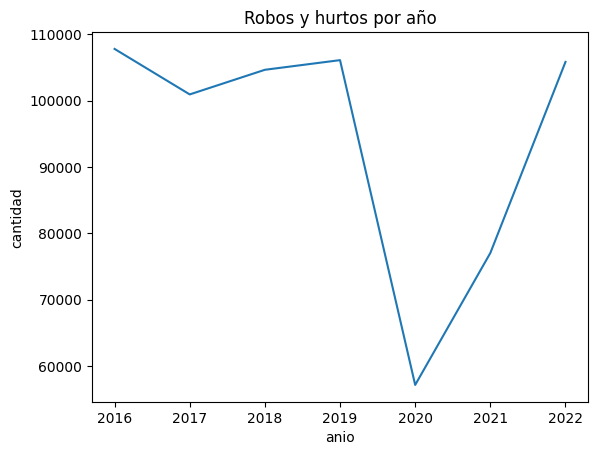

In [17]:
delitos_por_año = robos.groupby('anio').agg({'cantidad':'count'})

sns.lineplot(data = delitos_por_año,
             x = 'anio', 
             y = 'cantidad')

plt.title('Robos y hurtos por año')

Text(0.5, 1.0, 'Robos y hurtos por mes')

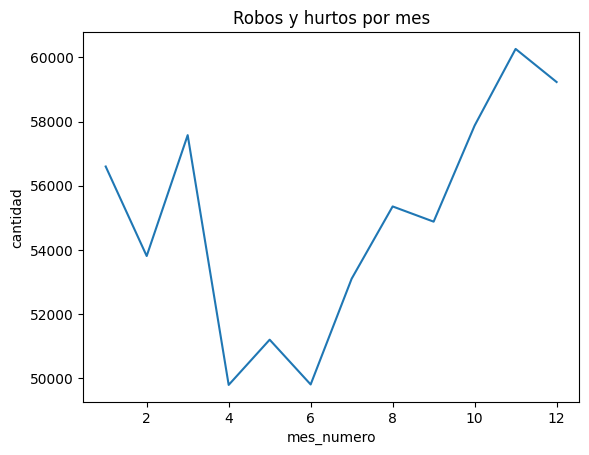

In [18]:
robos_por_mes = robos.groupby('mes_numero').agg({'cantidad':'count'})

sns.lineplot(data = robos_por_mes,
             x = 'mes_numero', 
             y = 'cantidad')

plt.title('Robos y hurtos por mes')

Text(0.5, 1.0, 'Robos y hurtos por día de la semana')

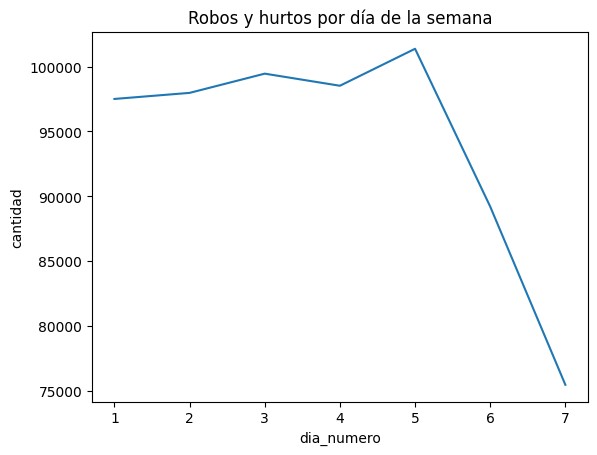

In [19]:
robos_por_dia = robos.groupby('dia_numero').agg({'cantidad':'count'})

sns.lineplot(data = robos_por_dia,
             x = 'dia_numero', 
             y = 'cantidad')

plt.title('Robos y hurtos por día de la semana')

In [20]:
robos_por_anio_mes = robos.groupby(['mes_numero','anio']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})
robos_por_anio_mes

delitos
mes_numero anio         
1          2016     8438
           2017     8486
           2018     8460
           2019     9147
           2020     8644
...                  ...
12         2018     9721
           2019     8795
           2020     5837
           2021     7445
           2022    10315

[84 rows x 1 columns]

Text(0.5, 1.0, 'Robos y hurtos por mes y año')

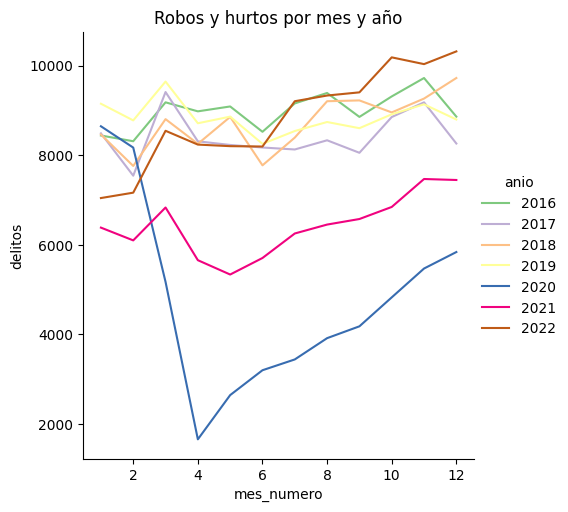

In [21]:
sns.relplot(data = robos_por_anio_mes,
             x = 'mes_numero', 
             y = 'delitos',
             kind = 'line',
             hue = 'anio',
             palette="Accent")

plt.title('Robos y hurtos por mes y año')

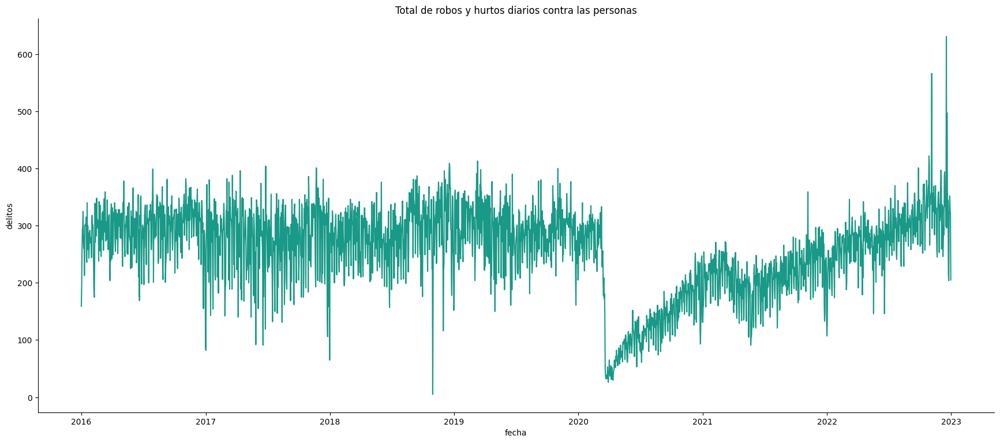

In [22]:
robos_por_dia = robos.groupby(['fecha']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})

sns.relplot(data = robos_por_dia,
             x = 'fecha', 
             y = 'delitos',
             kind = 'line',
             color='#199987')

plt.title('Total de robos y hurtos diarios contra las personas')
plt.gcf().set_size_inches(20, 8)

### 2018

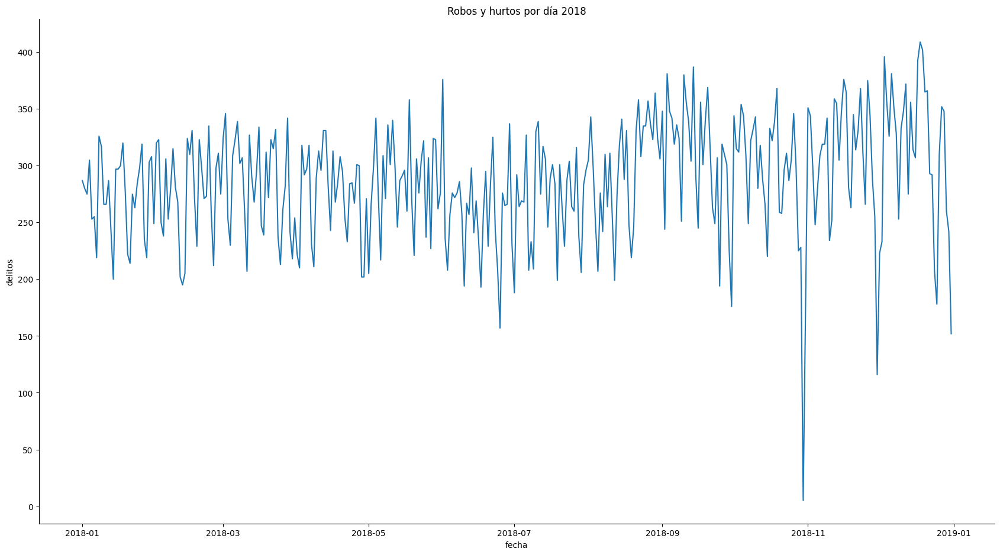

In [23]:
robos_por_dia_2018 = robos[robos['anio'] == 2018].groupby(['fecha']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})

sns.relplot(data = robos_por_dia_2018,
             x = 'fecha', 
             y = 'delitos',
             kind = 'line')

plt.title('Robos y hurtos por día 2018')
plt.gcf().set_size_inches(20, 10)

In [24]:
robos_por_dia_2018.sort_values('delitos', ascending= True).head(10)

,delitos
fecha,
2018-10-30,5
2018-11-30,116
2018-12-31,152
2018-06-25,157
2018-10-31,176
2018-09-30,176
2018-12-25,178
2018-07-01,188
2018-06-17,193


### 2020-2021

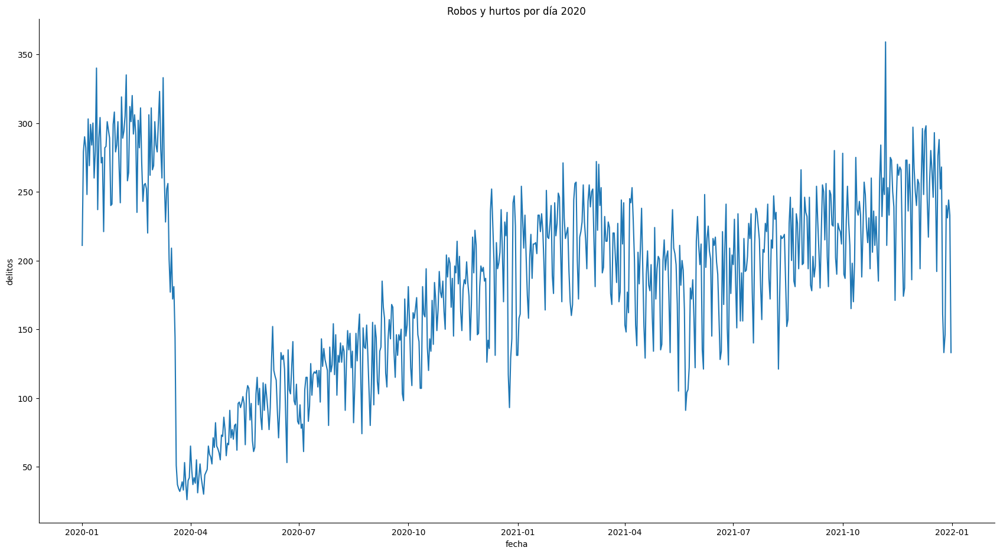

In [25]:
robos_por_dia_2020 = robos[(robos['anio'] == 2020) | (robos['anio'] == 2021)].groupby(['fecha']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})

sns.relplot(data = robos_por_dia_2020,
             x = 'fecha', 
             y = 'delitos',
             kind = 'line')

plt.title('Robos y hurtos por día 2020')
plt.gcf().set_size_inches(20, 10)

In [26]:
robos_por_dia.sort_values('delitos', ascending= False).head(10)

,delitos
fecha,
2022-12-18,631
2022-11-05,566
2022-12-20,497
2022-10-28,422
2019-03-11,413
2018-12-18,409
2022-10-29,404
2017-06-26,404
2018-12-19,402


### Distancia entre el lugar del hecho y la comisaría más cercana

In [27]:
from geopy.distance import geodesic as GD
 
robo1 =(-34.584136, -58.4547041)
comisaria57 =(-34.590420189796575, -58.451230393282835) # comisaria 57
 
print("The distance is: ", GD(robo1,comisaria57).m)

The distance is:  766.5161640930971


### Robos y hurtos por día y mes

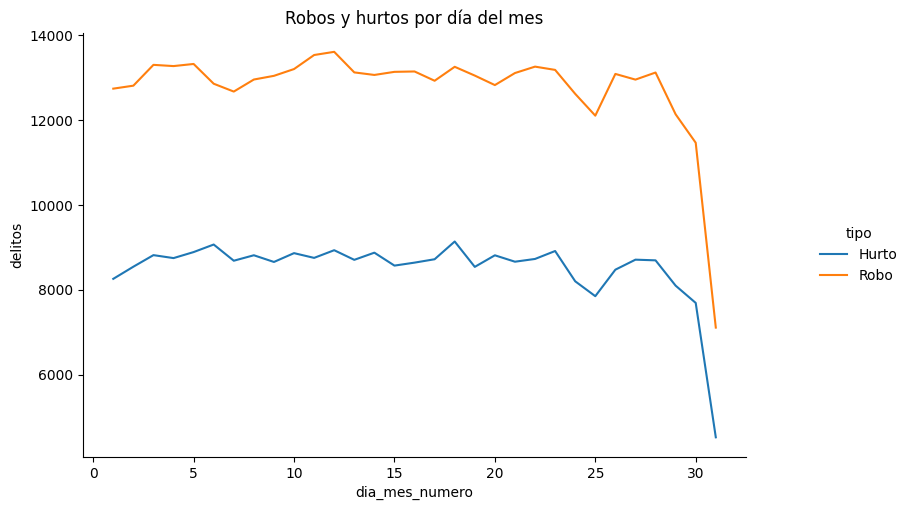

In [28]:
robos_por_dia_del_mes= robos.groupby(['dia_mes_numero', 'tipo']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})

sns.relplot(data = robos_por_dia_del_mes,
             x = 'dia_mes_numero', 
             y = 'delitos',
             hue = 'tipo',
             kind = 'line')

plt.title('Robos y hurtos por día del mes')
plt.gcf().set_size_inches(10, 5)

### Robos por hora y día

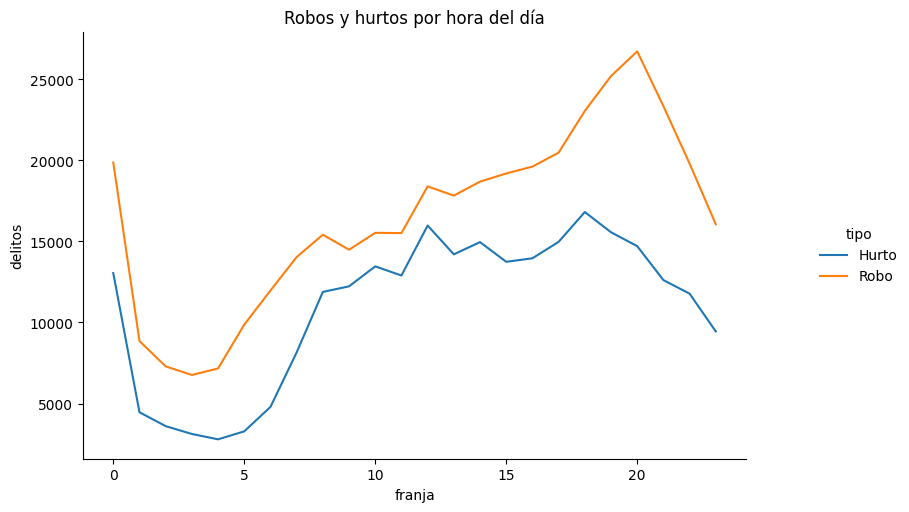

In [29]:
robos_por_hora_del_dia = robos.groupby(['franja', 'tipo']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})
robos_por_hora_del_dia

sns.relplot(data = robos_por_hora_del_dia,
             x = 'franja', 
             y = 'delitos',
             hue = 'tipo',
             kind = 'line')

plt.title('Robos y hurtos por hora del día')
plt.gcf().set_size_inches(10, 5)

### Robos por hora del día y por mes

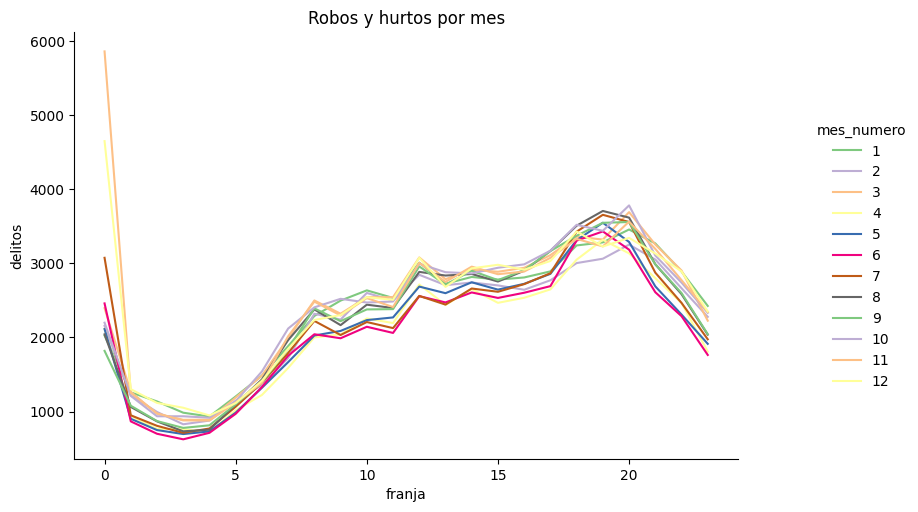

In [30]:
robos_por_hora_del_dia_por_mes = robos.groupby(['franja', 'mes_numero']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})


sns.relplot(data = robos_por_hora_del_dia_por_mes,
             x = 'franja', 
             y = 'delitos',
             kind = 'line',
             hue = 'mes_numero',
             palette="Accent")

plt.title('Robos y hurtos por mes')
plt.gcf().set_size_inches(10, 5)

### Mapa de los barrios de bs as

<Axes: xlabel='Longitud', ylabel='Latitud'>

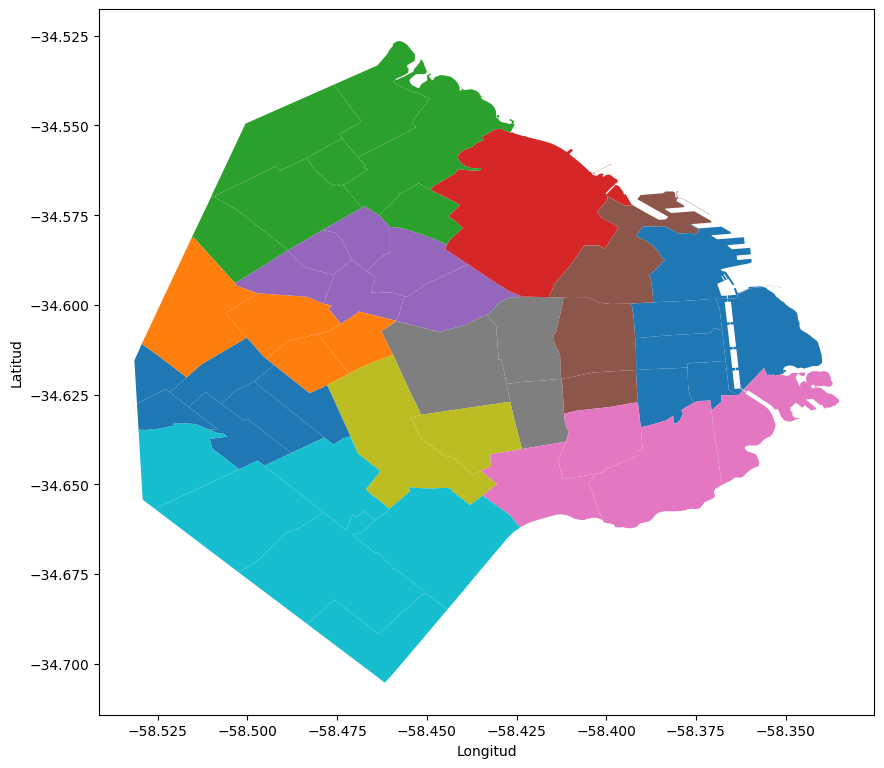

In [31]:
# Carga del GEOJson

baires_map = gpd.read_file('../Datasets/barrios.csv')

# Control del tamaño de la figura del mapa
fig, ax = plt.subplots(figsize=(10, 10))
 
# Control del título y los ejes
#ax.set_title('Natalidad por Provincias en España, 2018', 
#             pad = 20, 
#             fontdict={'fontsize':20, 'color': '#4873ab'})
ax.set_xlabel('Longitud')
ax.set_ylabel('Latitud')
 
# Mostrar el mapa finalizado
baires_map.plot(column='COMUNA',
                #cmap='plasma', 
                ax=ax, 
                zorder=5)


In [32]:
import plotly.express as px
import plotly.graph_objects as go

fig = go.Figure()
# Añadir puntos usando scatter_mapbox
fig.add_scattermapbox(
    lat=robos["latitud"],
    lon=robos["longitud"],
    mode="markers",
    marker=dict(size=10, color="red"),
    text=robos["id-mapa"],
    name="Puntos",
)


fig = px.choropleth_mapbox(data_frame=robos, 
                           #color="BARRIO",
                           geojson=barrios_geojson, 
                           locations="barrio", 
                           featureidkey="properties.region",
                           opacity=0.1,
                           color_continuous_scale='Viridis',
                           center={"lat": -34.6076, "lon": -58.4371},
                           mapbox_style="carto-positron", 
                           zoom=10.5)  # Adjust the zoom level as needed
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})





fig.show()

In [33]:
robos.subtipo.value_counts()

subtipo
Robo total     395996
Hurto total    263504
Name: count, dtype: int64

In [34]:


color_scale = [(0, 'orange'), (1,'red')]

fecha = '18/12/2022' # Argentina campeón
#fecha = '05/11/2022' # ¿?
#fecha = '20/12/2022' # Festejo con el equipo de argentina


fig = px.scatter_mapbox(robos[(robos['fecha'] == fecha)],#& (robos['tipo'] == 'Robo')], 
                        lat="latitud", 
                        lon="longitud", 
                        hover_name='dia_numero', 
                        #hover_data=["Address", "Listed"],
                        #color='#199987',
                        #color_continuous_scale='gray',
                        color_discrete_sequence=['#199987'],
                        #size="Listed",
                        zoom=8, 
                        height=800,
                        width=800)

#fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [35]:
color_scale = [(0, 'red'), (1, 'blue')]

filter = (robos['anio'] == 2022) & (robos['tipo'] == 'Robo')
filter = robos['id-mapa'] == 13840

fig = px.scatter_mapbox(robos[filter], 
                        lat="latitud", 
                        lon="longitud", 
                        hover_name='mes_numero', 
                        #color_discrete_sequence=['red'],  # Asigna color rojo para robos
                        color = 'mes_numero',
                        zoom=8, 
                        height=800,
                        width=800)

fig.add_trace(px.scatter_mapbox(comisarias, 
                                lat="lat", 
                                lon="long", 
                                hover_name='id', 
                                color_discrete_sequence=['blue'],  # Asigna color azul para comisarías
                                zoom=8, 
                                height=800,
                                width=800).data[0])

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Robo y hurto automotor

In [36]:
delitos.subtipo.unique()

array(['Hurto total', 'Robo total', 'Hurto automotor', 'Robo automotor',
       'Lesiones por siniestros viales', 'Muertes por siniestros viales'],
      dtype=object)

In [37]:
robos_autos = delitos[delitos['subtipo'].isin(['Hurto automotor', 'Robo automotor'])]
robos_autos.sort_values('fecha', ascending=False)

,id-mapa,anio,mes,dia,fecha,franja,tipo,subtipo,uso_arma,uso_moto,barrio,comuna,latitud,longitud,cantidad,mes_numero,dia_numero,dia_mes_numero,anio_mes
580418,83303,2022,DICIEMBRE,SABADO,2022-12-31,12.0,Hurto,Hurto automotor,NO,NO,PARQUE AVELLANEDA,9.0,-34.648806,-58.487699,1,12,6,31,2022-12
506397,9282,2022,DICIEMBRE,SABADO,2022-12-31,3.0,Robo,Robo automotor,SI,NO,SAN CRISTOBAL,3.0,-34.624645,-58.399100,1,12,6,31,2022-12
598055,100940,2022,DICIEMBRE,SABADO,2022-12-31,19.0,Hurto,Hurto automotor,NO,NO,LINIERS,9.0,-34.637287,-58.527290,1,12,6,31,2022-12
602921,105806,2022,DICIEMBRE,SABADO,2022-12-31,16.0,Robo,Robo automotor,SI,NO,VILLA LUGANO,8.0,-34.674990,-58.482357,1,12,6,31,2022-12
598054,100939,2022,DICIEMBRE,SABADO,2022-12-31,19.0,Hurto,Hurto automotor,NO,NO,LINIERS,9.0,-34.637298,-58.527282,1,12,6,31,2022-12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
730258,776672,2016,ENERO,VIERNES,2016-01-01,21.0,Hurto,Hurto automotor,NO,NO,CABALLITO,6.0,-34.626499,-58.435404,1,1,5,1,2016-01
666695,585984,2016,ENERO,VIERNES,2016-01-01,21.0,Robo,Robo automotor,SI,NO,VILLA SOLDATI,8.0,-34.662362,-58.439270,1,1,5,1,2016-01
678267,620700,2016,ENERO,VIERNES,2016-01-01,7.0,Robo,Robo automotor,NO,NO,NUEVA POMPEYA,4.0,-34.642640,-58.414754,1,1,5,1,2016-01
674500,609399,2016,ENERO,VIERNES,2016-01-01,11.0,Robo,Robo automotor,NO,NO,ALMAGRO,5.0,-34.610653,-58.419555,1,1,5,1,2016-01


### Robos de autos por día

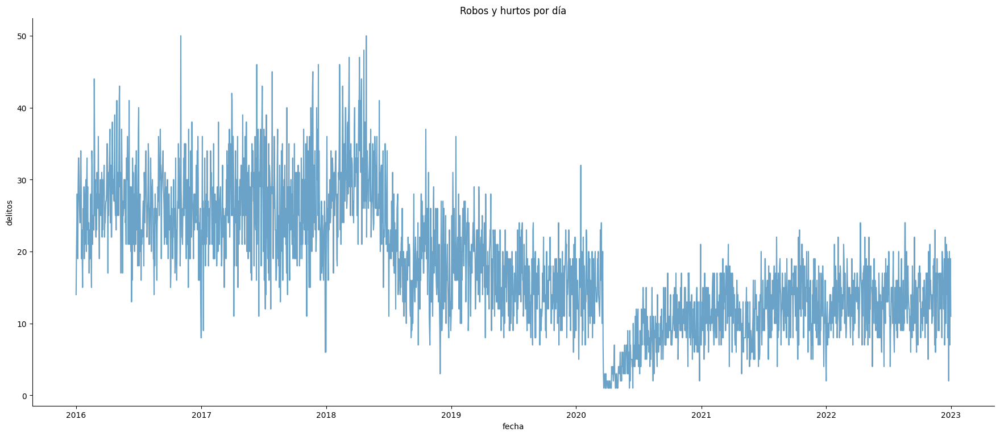

In [38]:
robos_autos_por_dia = robos_autos.groupby(['fecha']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})

sns.relplot(data = robos_autos_por_dia,
             x = 'fecha', 
             y = 'delitos',
             kind = 'line',
             color = '#6AA3C7')

plt.title('Robos y hurtos por día')
plt.gcf().set_size_inches(20, 8)

### Robos de autos por hora

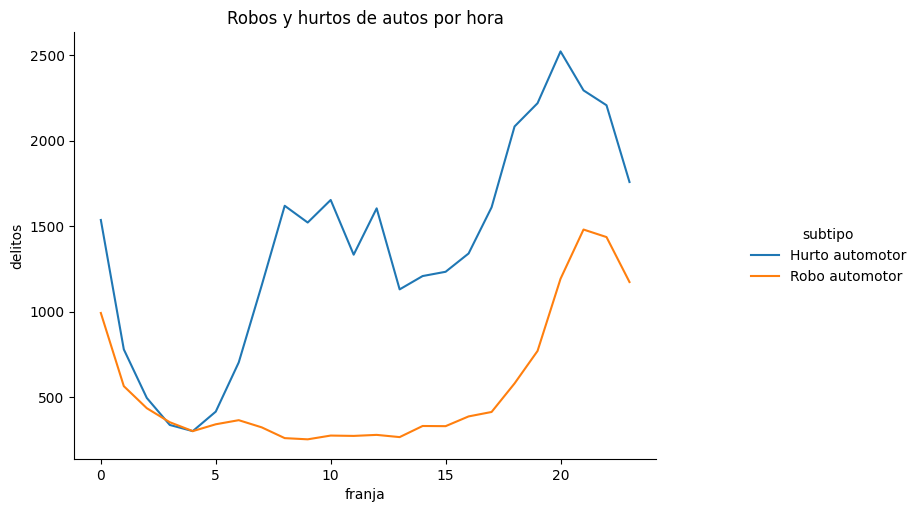

In [39]:
robos_autos_por_hora = robos_autos.groupby(['franja', 'subtipo']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'})

sns.relplot(data = robos_autos_por_hora,
             x = 'franja', 
             y = 'delitos',
             hue = 'subtipo',
             kind = 'line')

plt.title('Robos y hurtos de autos por hora')
plt.gcf().set_size_inches(10, 5)

### Robos de autos por localización

In [41]:
color_scale = [(0, 'red'), (1, 'blue')]

#filter = (robos_autos['anio'] == 2017) #& (robos['tipo'] == 'Robo')
filter = robos_autos['id-mapa'] == 102

fig = px.scatter_mapbox(robos_autos[filter], 
                        lat="latitud", 
                        lon="longitud", 
                        hover_name='mes_numero', 
                        #color_discrete_sequence=['red'],  # Asigna color rojo para robos
                        color = 'subtipo',
                        zoom=8, 
                        height=800,
                        width=800)

fig.add_trace(px.scatter_mapbox(comisarias, 
                                lat="lat", 
                                lon="long", 
                                hover_name='id', 
                                color_discrete_sequence=['blue'],  # Asigna color azul para comisarías
                                zoom=8, 
                                height=800,
                                width=800).data[0])

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Barrios

In [ ]:
delitos_por_barrio = delitos.groupby(['barrio','tipo']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'}).sort_values('delitos', ascending=False).reset_index()
delitos_por_barrio

In [ ]:
delitos_por_barrio_por_tipo = delitos_por_barrio.pivot(index="barrio", columns="tipo", values="delitos")
delitos_por_barrio_por_tipo.fillna(0,inplace=True)
delitos_por_barrio_por_tipo['total'] = delitos_por_barrio_por_tipo['Amenazas'] + delitos_por_barrio_por_tipo['Homicidios'] + delitos_por_barrio_por_tipo['Hurto'] + delitos_por_barrio_por_tipo['Lesiones'] + delitos_por_barrio_por_tipo['Robo'] + delitos_por_barrio_por_tipo['Vialidad']
delitos_por_barrio_por_tipo.sort_values('total', ascending=False, inplace= True)
delitos_por_barrio_por_tipo

In [ ]:
delitos_por_barrio = delitos.groupby(['barrio','tipo']).agg({'cantidad':'count'}).rename(columns = {'cantidad':'delitos'}).sort_values('delitos', ascending=False)

f, ax = plt.subplots(figsize=(6, 15))
sns.barplot(data = delitos_por_barrio_por_tipo,
             y = 'barrio', 
             x = 'total')

sns.barplot(data = delitos_por_barrio_por_tipo,
             y = 'barrio', 
             x = 'Robo')

In [ ]:
(ggplot(delitos.groupby('fecha')['cantidad'].count())         # defining what data to use
 + aes(x='fecha')    # defining what variable to use
 + geom_bar(size=20) # defining the type of plot to use
)

### Accidentes viales

In [12]:
delitos.tipo.value_counts()

tipo
Robo        409373
Hurto       296621
Vialidad     63483
Name: count, dtype: int64

In [30]:
delitos.subtipo.value_counts()

subtipo
Robo total                        395996
Hurto total                       263504
Lesiones por siniestros viales     62656
Hurto automotor                    33117
Robo automotor                     13377
Muertes por siniestros viales        827
Name: count, dtype: int64

In [27]:
delitos[delitos['tipo'] == 'Vialidad'].groupby('anio')['cantidad'].sum()

anio
2016     9036
2017     9991
2018    10209
2019    10177
2020     6066
2021     7823
2022    10181
Name: cantidad, dtype: int64

In [31]:
color_scale = [(0, 'red'), (1, 'blue')]

filter = ((delitos['tipo'] == 'Vialidad') & (delitos['anio'] == 2022))
filter = (delitos['anio'] == 2022)
filter = ((delitos['subtipo'] == 'Muertes por siniestros viales') & (delitos['anio'] == 2022))
#filter = robos['id-mapa'] == 1

fig = px.scatter_mapbox(delitos[filter], 
                        lat="latitud", 
                        lon="longitud", 
                        hover_name='mes_numero', 
                        #color_discrete_sequence=['red'],  # Asigna color rojo para robos
                        color = 'tipo',
                        zoom=8, 
                        height=800,
                        width=800)

fig.add_trace(px.scatter_mapbox(comisarias, 
                                lat="lat", 
                                lon="long", 
                                hover_name='id', 
                                color_discrete_sequence=['blue'],  # Asigna color azul para comisarías
                                zoom=8, 
                                height=800,
                                width=800).data[0])

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()